# 0. Initialize

## 0.1. Import Libraries

In [ ]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
import os, sys, glob
import gzip
import random
import tqdm
import json
import numpy as np
import pandas as pd
pd.set_option("display.max_columns", None)

from IPython import display
import matplotlib as mpl
from matplotlib import pyplot as plt
import imblearn

from imblearn.over_sampling import SMOTE

## 0.2. DEFINE VARIABLES 

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
datax = '/content/drive/MyDrive/CS412-PROJECT-PRIV/raw_data/'

Mounted at /content/drive/


In [ ]:
DATA_PATH = datax  # '<insert-your-training-data-path-here>'

ROUND = 3 # This project will have 3 rounds of predictions: 1,2,3
STUDENT_ID = '28308'#'<insert-your-id-here>'
PROJECT_CODE = ''#'<insert-your-code-here>' # Same code for the annotation eg. CS412xxxxx

## 0.3. Read Training & Evaluation Data

### 0.3.1. Get the labels for tweets

In [ ]:
#trainingTweetDf = pd.read_csv('{}training-tweet.csv'.format(DATA_PATH))
trainingTweetDf = pd.read_csv('{}training-tweet.csv'.format(DATA_PATH), dtype={'tweet_id': str, 'isPolitical': str})
trainingTweetDf

,tweet_id,isPolitical
0,1597170281545551872,Yes
1,1431700027471192069,No
2,1566035577090281472,Yes
3,1591538690869940225,Yes
4,1583898169238167554,Yes
...,...,...
2995,1593539327623151619,Yes
2996,1393886554062524418,No
2997,1597925615092764672,Yes
2998,1585291418616176640,Yes


In [ ]:
trainingTweetDf.isPolitical.value_counts()

Yes    2003
No      997
Name: isPolitical, dtype: int64

### 0.3.2. Get the labels for users

In [ ]:
trainingUserDf = pd.read_csv('{}training-user.csv'.format(DATA_PATH))
#trainingUserDf = pd.read_csv('training-user.csv')
trainingUserDf

,screen_name,isBot
0,koftecancaddy,No
1,ahaber,No
2,selahat03949652,No
3,erdin06357062,No
4,bhct__necatii,No
...,...,...
2995,djblumenberg,No
2996,mel1sq,No
2997,eren_yz1,Yes
2998,ergnyildiz4,No


In [ ]:
trainingUserDf.isBot.value_counts()

No     2424
Yes     576
Name: isBot, dtype: int64

### 0.3.3. Expand your dataset with metadata and tweets

In [ ]:
# You can also expand training data by downloading your own labeled datasets following the link
# Download the documents under "Link to training data"

print('http://www.onurvarol.com/Annotation-CS412-202201/reports/report_{}.html'.format(PROJECT_CODE))

http://www.onurvarol.com/Annotation-CS412-202201/reports/report_CS412c01af8ebe3df.html


# 1. EXTRACT FEATURES
Under *1.1. Political Tweet Detection* and *1.2. Bot Detection*, we firstly collect raw data for processing. We then combine some of them (total_interactions = num_favorites + num_retweets) or use them to extract features (whether the tweet has one of the political entities @meralaksener, @kilicdarogluk etc.).

We expect you to collect more raw data from **tweet_metadata**, **user_profiles** and **user_tweets** files by creating a function as shown in below examples such as *check_if_retweet()* and using it while iterating over data as shown under *Merge Collected Features*.

We also expect you to create new variables as much as you can from the data in order to make your predictions more accurate. For example, you may want to check:

- The tweet sources that a user frequently uses
- Whether the user is a verified account or not

...

to assess whether **a user is a bot or not** and whether **a tweet is political or not**.

In [ ]:
PATH_TO_DOWNLOADED = DATA_PATH # 'D:/Users/suuser/Desktop/Sabancı/CS412/spring-2022/project/'

## 1.1. Political Tweet Detection
This part stands for the feature extraction of tweets. We start with collecting the raw data from *tweet_metadata*, then use some of them to extract features.

### 1.1.1. Get Raw Data

#### 1.1.1.1. Check if Retweet

In [ ]:
def check_if_retweet(tweet_metadata_line):
    is_retweet = 0
    retweeted_username = None

    try:
        tweet_metadata_line['retweeted_status']
        retweeted_username = tweet_metadata_line['retweeted_status']['user']['screen_name'].lower()
        is_retweet = 1

    except KeyError:
        pass

    return is_retweet, retweeted_username

#### 1.1.1.2. Get Tweet Text

In [ ]:
def get_tweet_text(tweet_metadata_line):
    text = tweet_metadata_line['text']
    
    return text

#### 1.1.1.3. Get Tweet ID

In [ ]:
def get_tweet_id(tweet_metadata_line):
    id_str = tweet_metadata_line['id_str']
    
    return id_str

#### 1.1.1.4. Get Number of Mentions and Hashtags

In [ ]:
def get_number_mentions_hashtags(tweet_metadata_line):
    num_mentions = len(tweet_metadata_line['entities']['user_mentions'])
    num_hashtags = len(tweet_metadata_line['entities']['hashtags'])

    return num_mentions, num_hashtags

#### 1.1.1.5. Get Number of Retweets and Favorites

In [ ]:
def get_number_retweets_favorites(tweet_metadata_line):
    retweet_count = tweet_metadata_line['retweet_count']
    favorite_count = tweet_metadata_line['favorite_count']
    
    return retweet_count, favorite_count

#### 1.1.1.6. Get User Info

In [ ]:
def get_user_info(tweet_metadata_line):
    id = tweet_metadata_line['user']['id_str']
    screen_name = tweet_metadata_line['user']['screen_name'].lower()
    description = tweet_metadata_line['user']['description']
    return id, screen_name, description

1.1.1.7 Get Hashtags

In [ ]:
def get_hashtags(tweet_metadata_line):
    hashtags = [hashtag["text"] for hashtag in tweet_metadata_line["entities"]["hashtags"]]
    return hashtags

#### 1.1.1.8. Get Tweet Mentions Info

In [ ]:
def get_tweet_mentions(tweet_metadata_line):
  allUserMentions = tweet_metadata_line['entities']['user_mentions']
  allMentionedNames = []
  for mention in allUserMentions:
    allMentionedNames.append(mention['screen_name'])
  return allMentionedNames

In [ ]:
def get_account_verified(tweet_metadata_line):
    isVerified = tweet_metadata_line['user']['verified']
    return 1 if isVerified == 'true' else 0

In [ ]:
def get_follower_count(tweet_metadata_line):
    return int(tweet_metadata_line['user']['followers_count'])

### 1.1.2. Derive Manually Crafted Features

#### 1.1.2.1. Check for political entity in text

In [ ]:
def check_political_ent(text,politicList):
    
    # the list below can be modified and some new names may be added (or removed)
    list_of_entities = politicList
    entities_in_text = [ent for ent in list_of_entities if ent.lower() in text.lower()]
    number_entities = len(entities_in_text)
  
    return number_entities

#### 1.1.2.2. Number of total interactions

In [ ]:
def total_interactions(retweet_count, favorite_count):
    total_num_interactions = retweet_count + favorite_count
    
    return total_num_interactions

### 1.1.2. Collect data using the functions above and transform into a Pandas DataFrame

In [ ]:
with gzip.open(f"{PATH_TO_DOWNLOADED}tweet_metadata.jsons.gz", "rb") as f:
    counter = 0
    for line in f:
        line = json.loads(line)
        line = json.dumps(line)
        print(line)
        counter += 1
        if counter > 10:
          break

{"created_at": "Fri Nov 04 16:28:09 +0000 2022", "id": 1588568792984346624, "id_str": "1588568792984346624", "text": "Sosyal Hizmetin temelini \u00e7ocuk olu\u015fturur,\u00e7ocu\u011fun biyopsikososyal  geli\u015fim temellerinin at\u0131ld\u0131\u011f\u0131 e\u011fitim-\u00f6\u011fretim haya\u2026 https://t.co/BjpnjmPfL0", "truncated": true, "entities": {"hashtags": [], "symbols": [], "user_mentions": [], "urls": [{"url": "https://t.co/BjpnjmPfL0", "expanded_url": "https://twitter.com/i/web/status/1588568792984346624", "display_url": "twitter.com/i/web/status/1\u2026", "indices": [117, 140]}]}, "source": "<a href=\"http://twitter.com/download/android\" rel=\"nofollow\">Twitter for Android</a>", "in_reply_to_status_id": null, "in_reply_to_status_id_str": null, "in_reply_to_user_id": null, "in_reply_to_user_id_str": null, "in_reply_to_screen_name": null, "user": {"id": 920963718103650304, "id_str": "920963718103650304", "name": "Zeycak1611", "screen_name": "Maviruh_", "location": "Ankar

In [ ]:
dfPolitical = {'tweet_id':[],
              'is_retweet':[],
              'retweeted_username':[],
              'text':[],
              'num_mentions':[],
              'num_hashtags':[],
              'num_retweets':[],
              'num_favorites':[],
              'user_id':[],
              'user_screen_name':[],
              'user_description':[],
              'total_interactions':[],
              'mentiones':[],
              'hashtags':[],
               'verifiedAccount':[],
               'numFollowers':[]
               }


with gzip.open(f"{PATH_TO_DOWNLOADED}tweet_metadata.jsons.gz", "rb") as f:
    for line in f:
        line = json.loads(line)
        
        # raw data:
        id_str = get_tweet_id(line)
        is_retweet, retweeted_username = check_if_retweet(line)
        text = get_tweet_text(line)
        num_mentions, num_hashtags = get_number_mentions_hashtags(line)
        retweet_count, favorite_count = get_number_retweets_favorites(line)
        user_id_str, screen_name, user_description = get_user_info(line)

        # manually crafted data:
        #num_political_entities = check_political_ent(text)
        total_num_interactions = total_interactions(retweet_count, favorite_count)
        mentionedPeople = get_tweet_mentions(line)
        hashtags = get_hashtags(line)
        isVerified = get_account_verified(line)
        followerCount = get_follower_count(line)

        dfPolitical['tweet_id'].append(id_str)
        dfPolitical['is_retweet'].append(is_retweet)
        dfPolitical['retweeted_username'].append(retweeted_username)
        dfPolitical['text'].append(text)
        dfPolitical['num_mentions'].append(num_mentions)
        dfPolitical['num_hashtags'].append(num_hashtags)
        dfPolitical['num_retweets'].append(retweet_count)
        dfPolitical['num_favorites'].append(favorite_count)
        dfPolitical['user_id'].append(user_id_str)
        dfPolitical['user_screen_name'].append(screen_name)
        dfPolitical['user_description'].append(user_description)
        #dfPolitical['num_political_entities'].append(num_political_entities)
        dfPolitical['total_interactions'].append(total_num_interactions)
        dfPolitical['mentiones'].append(mentionedPeople)
        dfPolitical['hashtags'].append(hashtags)
        dfPolitical['verifiedAccount'].append(isVerified)
        dfPolitical['numFollowers'].append(followerCount)


In [ ]:
dfPolitical = pd.DataFrame(dfPolitical)
dfPolitical[dfPolitical['verifiedAccount']==0]

,tweet_id,is_retweet,retweeted_username,text,num_mentions,num_hashtags,num_retweets,num_favorites,user_id,user_screen_name,user_description,total_interactions,mentiones,hashtags,verifiedAccount,numFollowers
0,1588568792984346624,0,None,"Sosyal Hizmetin temelini çocuk oluşturur,çocuğ...",0,0,49,98,920963718103650304,maviruh_,shu/\nburaya afilli bir söz yazdığımı varsayın,147,[],[],0,284
1,1588452263047069697,0,None,"@mahirunal Gavur İzmir ya onlar, hani Cumhuriy...",1,0,0,0,595514060,mtfdan,,0,[mahirunal],[],0,131
2,1569589330544398336,0,None,#ŞehitAdayıUzmÇvşaKadro\nSiz İstesenizde Istem...,0,1,0,0,1356375754561490947,ahsucilginuzman,Vatan Sevdalisi,0,[],[ŞehitAdayıUzmÇvşaKadro],0,60
3,1570428119609139201,0,None,@ajans_muhbir Siz kaypak olmayıp onay vermesey...,1,0,0,0,1478775431008595968,hamitelkelle,HighOne,0,[ajans_muhbir],[],0,2
4,1551163840368414722,0,None,Engelli öğretmenler olarak önümüzdeki engeller...,0,0,0,0,1511976696337113088,sed58417690,,0,[],[],0,119
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33528,1568595408233832448,0,None,Gerçek kimlik taşımayan hesaplara cevap vermem...,0,0,9,81,576247173,ardanzenturk,RT ONAYLADIĞIM ANLAMINA GELMEZ\nArtık fikirler...,90,[],[],0,171399
33529,1584027427696959488,0,None,@umitozdag Neden Suriyelilerle ilgili bu kadar...,1,0,1,8,162308585,ozgul_61,Bridge design engineer Yaay hesabı : dilfiruz,9,[umitozdag],[],0,3936
33530,1585945783307730945,0,None,@celebimehmeta Niye Türkiye yüzyılıda.Türkiye ...,1,0,0,1,415025519,ladrekova,,1,[celebimehmeta],[],0,121
33531,1569748909521801221,1,muazzezeralp,RT @muazzezeralp: @Doan58213655 @denizkonur @N...,7,1,6,0,1442125177727307781,yapikytgrivrlsn,,6,"[muazzezeralp, Doan58213655, denizkonur, Nagih...",[imaraffıistiyoruz],0,591


In [ ]:
politicalTweets = trainingTweetDf[trainingTweetDf["isPolitical"] == "Yes"]
pTweetTable = dfPolitical[["tweet_id", "text", "hashtags","mentiones"]]
dfPoliticalTweets = pTweetTable.merge(politicalTweets, on="tweet_id")
hashtags = [hashtag for hashtaglist in dfPoliticalTweets["hashtags"] for hashtag in hashtaglist]
mentiones = [hashtag for hashtaglist in dfPoliticalTweets["mentiones"] for hashtag in hashtaglist]

In [ ]:
NONpoliticalTweets = trainingTweetDf[trainingTweetDf["isPolitical"] == "No"]
NonpTweetTable = dfPolitical[["tweet_id", "text", "hashtags","mentiones"]]
NonPoliticalTweets = NonpTweetTable.merge(NONpoliticalTweets, on="tweet_id")
non_politic_hashtags = [hashtag for hashtaglist in NonPoliticalTweets["hashtags"] for hashtag in hashtaglist]
non_politic_mentiones = [hashtag for hashtaglist in NonPoliticalTweets["mentiones"] for hashtag in hashtaglist]

In [ ]:
from collections import Counter


def most_common_words(texts, num_words=10):

  all_text = ' '.join(texts)
  words = all_text.split()
  word_counts = Counter(words)

  return word_counts.most_common(num_words)

def calculateWordScore(x, dfWords):
    score = 0
    words = dfWords["word"].tolist()
    text_words = x.split(" ")
    for text_word in text_words:
        if text_word in words:
            score += dfWords.loc[dfWords["word"] == text_word]["counter"].iloc[0]
    return score

def calculateListScore(x, dfWords,col):
    score = 0
    words = dfWords[col].tolist()
    text_words = x
    for text_word in text_words:
        if text_word in words:
            score += dfWords.loc[dfWords[col] == text_word]["counter"].iloc[0]
    return score


tweets = dfPoliticalTweets["text"].tolist()
mostCommon_political_words = dict(most_common_words(tweets, 300))
mostCommon_political_hashtags = dict(most_common_words(hashtags, 300))
mostCommon_political_mentiones = dict(most_common_words(mentiones, 300))

print(mostCommon_political_words)

Nonptweets = NonPoliticalTweets["text"].tolist()
NonPmostCommon_political_words = dict(most_common_words(Nonptweets, 300))
NonPmostCommon_political_hashtags = dict(most_common_words(non_politic_hashtags, 300))
NonPmostCommon_political_mentiones = dict(most_common_words(non_politic_mentiones, 300))


print(len(Nonptweets))
print(NonPmostCommon_political_words)
NonPmostCommon_political_hashtags
NonPmostCommon_political_mentiones


common_words = ["ve", "bir", "bu", "ben", "sen", "o", "biz", "siz",
                "onlar","ama","bir","da","çok", "az", "kadar",
                "daha","mi","olmak","için","sonra","önce","de","ile","?", "mı",
                "olarak", "ne", "bizi", "sizde","O","her", "yıl", "bak", "Ne", "tüm", "var", "olan", "iyi", "neden", "olmuş",
                "olsun","ya","Bu","Ben","şey","bi","güzel",
                "en","cennet","gibi","mekanı","gün","yok","böyle","Günaydın","değil","devam","sana","olur","bile", "I","hem","diye","hiç","benim","tek","3","oldu",
                "senin","Çok","-","mu","öyle","seni","2","1"]
for k in common_words:
    mostCommon_political_words.pop(k,None)
    mostCommon_political_hashtags.pop(k,None)
    mostCommon_political_mentiones.pop(k,None)

for m in common_words:
    NonPmostCommon_political_words.pop(m,None)
    NonPmostCommon_political_hashtags.pop(m,None)
    NonPmostCommon_political_mentiones.pop(m,None)

for k,v in mostCommon_political_words.items():
  for k1,v1 in NonPmostCommon_political_words.items():
    if k == k1:
      mostCommon_political_words[k] = mostCommon_political_words[k] - NonPmostCommon_political_words[k1]

for k,v in mostCommon_political_hashtags.items():
  for k1,v1 in NonPmostCommon_political_hashtags.items():
    if k == k1:
      mostCommon_political_hashtags[k] = mostCommon_political_hashtags[k] - NonPmostCommon_political_hashtags[k1]

for k,v in mostCommon_political_mentiones.items():
  for k1,v1 in NonPmostCommon_political_mentiones.items():
    if k == k1:
      mostCommon_political_mentiones[k] = mostCommon_political_mentiones[k] - NonPmostCommon_political_mentiones[k1]
# round 1 den sonra yazılanlar---------------------------------------------------
#mostCommon_political_words =  {k.lower(): v for k, v in mostCommon_political_words.items()}
#eklenecekPoliticalWords = ["tayyip", "reis", "devlet", "hükümet", "ekonomi","bakan", "bakanı", "bakanlık", "cumhuriyet", "parti", "hdp", "pkk", "dhkp-c", 
#                         "suriye", "göçmen", "sığınmacı", "demokrat", "demokrasi", "seçim","oy", "belediye", "tarım","terör"]                       
# round 1 den sonra yazılanlar-------------------------------------------------------------




dfPoliticalWords = pd.DataFrame({"word" : mostCommon_political_words.keys(),
                                "counter" : mostCommon_political_words.values()
                                })
dfHashtags = pd.DataFrame({"hashtag" : mostCommon_political_hashtags.keys(),
                            "counter" : mostCommon_political_hashtags.values()
                            })
dfMentiones = pd.DataFrame({"mention" : mostCommon_political_mentiones.keys(),
                            "counter" : mostCommon_political_mentiones.values()
                            })



#NORMALIZING
dfPoliticalWords["counter"] = (dfPoliticalWords["counter"] - dfPoliticalWords["counter"].min()) / (dfPoliticalWords["counter"].max() - dfPoliticalWords["counter"].min()) + 0.1
dfHashtags["counter"] = (dfHashtags["counter"] - dfHashtags["counter"].min()) / (dfHashtags["counter"].max() - dfHashtags["counter"].min()) + 0.1
dfMentiones["counter"] = (dfMentiones["counter"] - dfMentiones["counter"].min()) / (dfMentiones["counter"].max() - dfMentiones["counter"].min()) + 0.1 


# round 1 den sonra yazılanlar-------------------------------------------------------------
#mergelencekDict = {}
#for w in eklenecekPoliticalWords:
#  mergelencekDict[w] = 1.1

#eklencekDF = pd.DataFrame({"word": mergelencekDict.keys(),
#                          "counter" : mergelencekDict.values()
#                          })
#dfPoliticalWords.append(eklencekDF, ignore_index = True) #round 1 den sonra eklendi
# round 1 den sonra yazılanlar-------------------------------------------------------------



print(dfPoliticalWords.head(50))
print('----------')
print(dfPoliticalWords.tail(50))
print('----------')


dfPolitical["hashtagScore"] = dfPolitical['hashtags'].apply(lambda x : calculateListScore(x, dfHashtags, "hashtag"))
dfPolitical["mentionScore"] = dfPolitical['mentiones'].apply(lambda x : calculateListScore(x, dfMentiones, "mention"))
dfPolitical['wordScore'] = dfPolitical['text'].apply(lambda x : calculateWordScore(x, dfPoliticalWords))
dfPolitical[["tweet_id","wordScore","hashtagScore", "mentionScore"]]
'''
finalDict = {**mostCommon_political_hashtags,**mostCommon_political_mentiones,**mostCommon_political_words}
finalDict = mostCommon_political_words.update(mostCommon_political_mentiones)
mostCommon_political_words
'''

{'@RTErdogan': 341, 've': 193, 'bir': 180, 'bu': 130, 'Sayın': 127, '@kilicdarogluk': 122, '@meral_aksener': 109, 'için': 108, 'de': 77, 'ile': 75, 'olarak': 75, 'ne': 74, 'atama': 74, '@vedatbilgn': 69, 'Bu': 69, '@drfahrettinkoca': 63, '@umitozdag': 63, '@suleymansoylu': 62, '@ekrem_imamoglu': 59, 'da': 52, 'çok': 49, 'bin': 49, 'en': 49, 'gibi': 41, 'her': 41, 'kadar': 40, 'kadro': 39, 'yok': 39, 'o': 36, 'bekliyor': 34, 'daha': 34, 'değil': 33, 'ama': 33, '@Akparti': 33, 'olsun': 32, 'Ziraat': 32, 'var': 32, 'sayın': 32, '100': 31, 'siz': 31, 'Biz': 30, 'istiyoruz': 30, '@akaraismailoglu': 29, 'Engelli': 29, 'mi': 28, 'öğretmen': 28, 'olmak': 28, '@06melihgokcek': 28, 'artık': 28, '@dbdevletbahceli': 28, 'Bir': 26, 'olan': 26, '@NureddinNebati': 26, 'yıl': 25, 'ki': 24, 'lütfen': 24, 'iyi': 24, '3004': 24, 'SOSYAL': 24, 'GÜVENLİK': 24, '@TCAytunCiray': 24, 'Allah': 23, '?': 23, '@eczozgurozel': 23, 'sen': 23, '@celebimehmeta': 23, '15': 22, '@tcmeb': 22, 'neden': 22, '@alimahir': 2

'\nfinalDict = {**mostCommon_political_hashtags,**mostCommon_political_mentiones,**mostCommon_political_words}\nfinalDict = mostCommon_political_words.update(mostCommon_political_mentiones)\nmostCommon_political_words\n'

In [ ]:
print(mostCommon_political_words)
print(NonPmostCommon_political_words)




{'@RTErdogan': 306, 'Sayın': 113, '@kilicdarogluk': 107, '@meral_aksener': 97, 'atama': 68, '@vedatbilgn': 64, '@drfahrettinkoca': 44, '@umitozdag': 52, '@suleymansoylu': 50, '@ekrem_imamoglu': 55, 'bin': 41, 'kadro': 32, 'bekliyor': 31, '@Akparti': 30, 'Ziraat': 32, 'sayın': 32, '100': 24, 'Biz': 25, 'istiyoruz': 26, '@akaraismailoglu': 29, 'Engelli': 29, 'öğretmen': 28, '@06melihgokcek': 28, 'artık': 25, '@dbdevletbahceli': 28, 'Bir': 19, '@NureddinNebati': 26, 'ki': 12, 'lütfen': 19, '3004': 24, 'SOSYAL': 24, 'GÜVENLİK': 24, '@TCAytunCiray': 24, 'Allah': -2, '@eczozgurozel': 23, '@celebimehmeta': 20, '15': 22, '@tcmeb': 15, '@alimahir': 22, '@AvOzlemZengin': 21, '@enginozkoc': 21, 'Sn': 21, '@RTErdogan…': 21, 'Adil': 17, '@Mustafa_Destici': 21, 'vekilim': 18, 'öğretmenler': 17, '@tcbestepe': 17, 'nasıl': 13, 'ÖN': 20, 'LİSANS': 20, 'size': 14, 'bakanım': 20, '@alpayozalan35': 19, 'Siz': 13, 'hak': 19, 'sadece': 15, '@varank': 9, 'istiyoruz.': 18, 'zaman': 12, 'büyük': 13, 'KADRO': 1

In [ ]:
print(mostCommon_political_words)
print(NonPmostCommon_political_words)
print(mostCommon_political_words)

{'@RTErdogan': 306, 'Sayın': 113, '@kilicdarogluk': 107, '@meral_aksener': 97, 'atama': 68, '@vedatbilgn': 64, '@drfahrettinkoca': 44, '@umitozdag': 52, '@suleymansoylu': 50, '@ekrem_imamoglu': 55, 'bin': 41, 'kadro': 32, 'bekliyor': 31, '@Akparti': 30, 'Ziraat': 32, 'sayın': 32, '100': 24, 'Biz': 25, 'istiyoruz': 26, '@akaraismailoglu': 29, 'Engelli': 29, 'öğretmen': 28, '@06melihgokcek': 28, 'artık': 25, '@dbdevletbahceli': 28, 'Bir': 19, '@NureddinNebati': 26, 'ki': 12, 'lütfen': 19, '3004': 24, 'SOSYAL': 24, 'GÜVENLİK': 24, '@TCAytunCiray': 24, 'Allah': -2, '@eczozgurozel': 23, '@celebimehmeta': 20, '15': 22, '@tcmeb': 15, '@alimahir': 22, '@AvOzlemZengin': 21, '@enginozkoc': 21, 'Sn': 21, '@RTErdogan…': 21, 'Adil': 17, '@Mustafa_Destici': 21, 'vekilim': 18, 'öğretmenler': 17, '@tcbestepe': 17, 'nasıl': 13, 'ÖN': 20, 'LİSANS': 20, 'size': 14, 'bakanım': 20, '@alpayozalan35': 19, 'Siz': 13, 'hak': 19, 'sadece': 15, '@varank': 9, 'istiyoruz.': 18, 'zaman': 12, 'büyük': 13, 'KADRO': 1

In [ ]:
finalDict = {**mostCommon_political_hashtags,**mostCommon_political_mentiones,**mostCommon_political_words}
finalList = list(finalDict.keys())
additionalEntities = ['meral_aksener', 'kilicdarogluk', 'vekilince', 'RTErdogan', 'MevlutCavusoglu', 'umitozdag', "tayyip", "reis", "devlet", "hükümet", "ekonomi","bakan",
                    "bakanı", "bakanlık", "cumhuriyet", "parti", "hdp", "pkk", "dhkp-c", "suriye", "göçmen",
                    "sığınmacı", "demokrat", "demokrasi", "seçim","oy", "belediye", "tarım","terör", "zam", "dolar", "fatura", "türk lirası", "afgan", "pakistan"
                    "savaş", "şehit", "şehitler", "muhalefet", "troll", "koalisyon", "milletvekili", "vekil", "feto", "15 temmuz", "miting", "solcu", "sağcı", "yobaz"
                    "siyaset", "siyasi", "başkan", "meral", "kemal", "tayyip", "enflasyon", "Türkiye", "demokrasi", "cumhurbaşkanı", "cumhurbaşkanım", "cumhurbaşkanımız",
                    "siyasi parti", "sosyal adalet", "adalet", "milliyetçilik", "anayasa", "yasa", "yargı", "yürütme", "din", "laiklik", "laik", "politika", "politik",
                    "@eczozgurozel", "@BY", "@ATuncayOzkan", "@NumanKurtulus", "@abdulhamitgul", "@samiltayyar27", "@sahmetsahmet", "@aykuterdogdu", "@efkanala", "@oktayvural", "@mahirunal", "@Y_Akdogan", "@mustafabalbay","@ahmetarslan", "@Hayati_Yazici", "@korayaydintr","@drbetulsayan","@selinsayekboke","@veliagbaba","@enginozkoc", "@enginaltaychp", "@turanbulent", "@jsarieroglu","@yavuzagiraliog","@nurettincanikli","@_cevdetyilmaz","@AylinNazliaka", "@avhamzadag", "@gurselerol62", "@erolkaya_ist", "@aliihsanyavuz54", "@mustafaelitas", "@KarakayaMevlut", "@gurseltekin34",
                    "@BurhanKuzu", "@yusufhalacoglu", "@ackilic76", "@ozturkyilmazYP", "@AvOzlemZengin", "@fikriisik", "@selvacam", "@CK_Samsun", "@vedatdemiroz",
                    "@erkankandemir", "@ali_ihsanarslan", "devlet", "beyin göçü", "göç", "antlaşma", "gelir", 
                     "zam", "kandil", "faşizm", "faşist", "ocalan", "apo", "benzin", "euro", "türk lirası", "geriledi", "kalkışma", "elektrik", "sıcak su", "doğal gaz", "bedelli", "fetöcü", "bakanlık"]
for i in additionalEntities:
    finalList.append(i)

In [ ]:
dfPolitical['num_political_entities'] = dfPolitical['text'].apply(lambda x : check_political_ent(x,finalList))

## 1.2. From Users

### 1.2.1. Get user metadata from user_profiles.jsons.gz

#### 1.2.1.1. Get user info metadata

In [ ]:
def get_user_info_metadata(user_metadata_line):
    
    user_id = user_metadata_line['id_str']
    user_name = user_metadata_line['name']
    user_screen_name = user_metadata_line['screen_name'].lower()
    user_location = user_metadata_line['location']
    user_description = user_metadata_line['description']
    user_followers_count = user_metadata_line['followers_count']
    user_friends_count = user_metadata_line['friends_count']
    
    dictionary = {'user_id':user_id, 'user_name': user_name, 'user_screen_name':user_screen_name, 'user_location':user_location,
     'user_description':user_description, 'user_followers_count':user_followers_count, 'user_friends_count':user_friends_count}

    return dictionary

#### 1.2.1.2. Get followers/(followers+friends) ratio

In [ ]:
def get_followers_all_ratio(user_followers_count, user_friends_count):
    
    if user_friends_count + user_followers_count == 0:
        followers_all_ratio = 0

    else:
        followers_all_ratio =  user_followers_count / (user_friends_count + user_followers_count)

    return followers_all_ratio

#### 1.2.1.3. Get description length

In [ ]:
def get_desc_len(user_description):
    
    description_len = len(user_description)

    return description_len

In [ ]:
dfBot = {'user_id':[],
         'user_name':[],
         'user_screen_name':[],
         'user_location':[],
         'user_description':[],
         'user_followers_count':[],
         'user_friends_count':[],
         'description_len':[],
         'followers_to_all_ratio':[]}

with gzip.open(f"{PATH_TO_DOWNLOADED}user_profiles.jsons.gz", "rb") as f:
    for line in f:
        line = json.loads(line)

        dictionary = get_user_info_metadata(line)
        for k,v in dictionary.items():
            dfBot[k].append(v)

        
        # manually crafted data:
        description_len = get_desc_len(dictionary['user_description'])
        dfBot['description_len'].append(description_len)
        
        followers_all_ratio = get_followers_all_ratio(dictionary['user_followers_count'], 
                                                      dictionary['user_friends_count'])

        dfBot['followers_to_all_ratio'].append(followers_all_ratio)

In [ ]:
dfBot = pd.DataFrame(dfBot)


### 1.2.2. Get Tweet Info of Users in user_profiles.jsons.gz

#### 1.2.2.1. Check ratio of retweets to all tweets

In [ ]:
def get_retweet_tweet_ratio(line):
    number_retweets = 0
    number_original_tweets = 0

    for tweet in line['tweets']:
        try:
            tweet['retweeted_status']
            number_retweets += 1
                
        except:
            number_original_tweets += 1
            
    total_tweets = number_retweets + number_original_tweets
    
    if total_tweets == 0:
        retweet_total_ratio = None
    else:
        retweet_total_ratio = number_retweets/(total_tweets)
    
    return retweet_total_ratio

#### 1.2.2.2. Check median number of favorites

In [ ]:
def get_median_number_favorites(line):
    num_median_favorites = np.median([tweet['favorite_count'] for tweet in line['tweets']])

    return num_median_favorites

### 1.2.3. Collect data using the functions above and transform into a Pandas DataFrame

In [ ]:
dfBotTweets = {'user_id':[],
               'retweet_total_ratio':[],
               'num_median_favorites':[],
               'num_of_tweets':[]
              }

i = 0

with gzip.open(f"{PATH_TO_DOWNLOADED}user_tweets.jsons.gz", "rb") as f:
    for line in f:

        line = json.loads(line)

        user_id = line['user_id']
        dfBotTweets['user_id'].append(user_id)
        
        retweet_total_ratio = get_retweet_tweet_ratio(line)
        dfBotTweets['retweet_total_ratio'].append(retweet_total_ratio)
        
        num_median_favorites = get_median_number_favorites(line)
        dfBotTweets['num_median_favorites'].append(num_median_favorites)
        
        dfBotTweets['num_of_tweets'].append(len(line['tweets']))

        i += 1
        if i % 1000 == 0:
            print(i)
            print(line)

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


1000
{'tweets': [{'created_at': 'Sat Dec 10 11:17:04 +0000 2022', 'id': 1601536472892731392, 'id_str': '1601536472892731392', 'text': 'Bana noluyo', 'truncated': False, 'entities': {'hashtags': [], 'symbols': [], 'user_mentions': [], 'urls': []}, 'source': '<a href="http://twitter.com/download/android" rel="nofollow">Twitter for Android</a>', 'in_reply_to_status_id': None, 'in_reply_to_status_id_str': None, 'in_reply_to_user_id': None, 'in_reply_to_user_id_str': None, 'in_reply_to_screen_name': None, 'user': {'id': 1226968305149390850, 'id_str': '1226968305149390850', 'name': '𝖉𝖔𝖘𝖊 - 𝖆𝖋', 'screen_name': 'berkaylanbu', 'location': 'Sinaloa, México', 'description': 'ne şekil?', 'url': 'https://t.co/KB7hwDp2CS', 'entities': {'url': {'urls': [{'url': 'https://t.co/KB7hwDp2CS', 'expanded_url': 'https://www.instagram.com/doseakapank/', 'display_url': 'instagram.com/doseakapank/', 'indices': [0, 23]}]}, 'description': {'urls': []}}, 'protected': False, 'followers_count': 155, 'friends_count':

In [ ]:
dfBotTweets = pd.DataFrame(dfBotTweets)
#dfBot['num_of_tweets'].isna().sum()
dfBotTweets

,user_id,retweet_total_ratio,num_median_favorites,num_of_tweets
0,594642154,0.115000,2.0,200
1,525600289,0.005025,1.0,199
2,931895965501534209,0.900000,0.0,200
3,1591543462746329088,0.185000,0.0,200
4,734801354749796352,1.000000,0.0,200
...,...,...,...,...
28310,1591370361488252928,0.800000,0.0,200
28311,1475272459616235525,0.825000,0.0,200
28312,1096753792731750401,0.051020,1.0,196
28313,1269527617687953409,0.095000,2.0,200


### 1.2.3. Merge dfBot and dfBotTweets

In [ ]:
dfBotAll = dfBot.merge(dfBotTweets,
                       how='left')

dfBotAll[['retweet_total_ratio', 'num_median_favorites']] = dfBotAll[['retweet_total_ratio', 'num_median_favorites']].fillna(0)

dfBotAll
dfBotAll['num_of_tweets'].isna().sum()
dfBotAll[['num_of_tweets']] = dfBotAll[['num_of_tweets']].fillna(0)
dfBotAll

,user_id,user_name,user_screen_name,user_location,user_description,user_followers_count,user_friends_count,description_len,followers_to_all_ratio,retweet_total_ratio,num_median_favorites,num_of_tweets
0,1431241870848450577,Nasreena Khan Wazir,nasreenakhan006,"Islamabad, Pakistan",Student,65,185,7,0.260000,0.395939,0.0,197.0
1,1304340303080386560,fania :((((,scorpiehoez,bogor,have a holly jolly🎄,8235,3011,19,0.732260,0.125000,0.0,200.0
2,1116042038577958914,Yusuf Aksoy,yusufak63712920,,"Bir şeyden pişmanlık duymak istemiyorsan,her ş...",95,399,64,0.192308,0.910000,0.0,200.0
3,4859899931,Be (VIXX6) ama oppalarının düğününe gidemiyor,nedenburdaysam,Hufflepuff ortak salon,"SMStan\n/St☆rlight ///come on girls,this is ou...",40,83,65,0.325203,0.015306,1.0,196.0
4,2225373636,SLMDMR,biologselim,,BİYOLOG🔬🦠\nNanoteknoloji,100,98,23,0.505051,0.659898,0.0,197.0
...,...,...,...,...,...,...,...,...,...,...,...,...
29665,1320834618220781569,islammm,islam_mrsj,,,229,217,0,0.513453,0.015000,1.0,200.0
29666,111074128,Melda Onur,meldaonur,,"Şekersiz çay, etsiz sofra, SAVAŞSIZ dünya... 🐌...",212457,5428,100,0.975088,0.291457,2.0,199.0
29667,36946875,ali ydm,ali_ydm,"İstanbul, Türkiye",hayat oyunsa bende jeton çok,116,141,28,0.451362,0.061538,0.0,195.0
29668,2389587396,Türkan Usta,turkanusta,"Ankara, Türkiye",Ustaya sormuşlar; hayatta yaptığın en büyük is...,1669,3639,116,0.314431,0.995000,0.0,200.0


# 2. TRAIN MODEL

## 2.1. Political Tweet Prediction

### 2.1.1. Merge dfPolitical data with labels

In [ ]:
dfPoliticalAll_train = dfPolitical.merge(trainingTweetDf,
                                         on='tweet_id')

dfPoliticalAll_train.head()

,tweet_id,is_retweet,retweeted_username,text,num_mentions,num_hashtags,num_retweets,num_favorites,user_id,user_screen_name,user_description,total_interactions,mentiones,hashtags,verifiedAccount,numFollowers,hashtagScore,mentionScore,wordScore,num_political_entities,isPolitical
0,1585955683513798656,0,None,@AvOzlemZengin YüzüncüYıla YakışanGenelAf adli...,1,0,3,2,1564992353168941058,zehra78231638,,5,[AvOzlemZengin],[],0,221,0.000000,0.159829,0.614286,13,Yes
1,1597631718479261696,0,None,#TCYüzyılıÜcretliÖgrtKadro\n#TCYüzyılıÜcretliÖ...,0,2,30,28,1324630334416297985,nurozguler,,58,[],"[TCYüzyılıÜcretliÖgrtKadro, TCYüzyılıÜcretliÖg...",0,455,0.771429,0.000000,0.533766,11,Yes
2,1572522789948751874,0,None,Ekrem İmamoğlu davayı değerlendirdi. 'Boş işle...,0,0,5,66,407597071,onediocom,Türkiye'nin ilk ve tek sosyal içerik sitesi ht...,71,[],[],0,735643,0.000000,0.000000,0.287662,5,Yes
3,1591412481561624577,0,None,Sayın Bakanım @suleymansoylu POMEM önlisans er...,1,0,0,0,1394789887073738753,buckybarnestr,...,0,[suleymansoylu],[],0,10,0.000000,0.259544,1.029870,16,Yes
4,1596914274907348992,0,None,"@varank Sayın bakanım, Bodrumdaki bu araziyi ...",1,0,0,0,1586083256088371201,sayariahmet,,0,[varank],[],0,6,0.000000,0.125641,0.609091,12,Yes


### 2.1.2. Separate X and y values
We only use 3 features here to create a baseline model. However, it is not enough to get good results.

In [ ]:
X = dfPoliticalAll_train[['num_political_entities','num_hashtags','num_mentions', 'wordScore', 'hashtagScore', 'mentionScore']]
#X = dfPoliticalAll_train[['num_political_entities','total_interactions','num_hashtags','num_mentions', 'num_retweets']]
#X = dfPoliticalAll_train[['is_retweet','num_favorites','num_political_entities','total_interactions','num_hashtags','num_mentions','hashtagScore', 'mentionScore','num_retweets']]
#X = dfPoliticalAll_train
y = dfPoliticalAll_train['isPolitical'].apply(lambda x: 1 if x=='Yes' else 0)
#X['isPolitical'] = X['isPolitical'].apply(lambda x: 1 if x=='Yes' else 0)
X

,num_political_entities,num_hashtags,num_mentions,wordScore,hashtagScore,mentionScore
0,13,0,1,0.614286,0.000000,0.159829
1,11,2,0,0.533766,0.771429,0.000000
2,5,0,0,0.287662,0.000000,0.000000
3,16,0,1,1.029870,0.000000,0.259544
4,12,0,1,0.609091,0.000000,0.125641
...,...,...,...,...,...,...
2995,6,0,1,0.197403,0.000000,0.188319
2996,15,0,4,0.138961,0.000000,1.428490
2997,12,0,3,0.174675,0.000000,1.676068
2998,7,0,1,0.271429,0.000000,0.119943


### 2.1.3. Train - validation split

In [ ]:
oversample = SMOTE()
X, y = oversample.fit_resample(X, y)

In [ ]:
X

,num_political_entities,num_hashtags,num_mentions,wordScore,hashtagScore,mentionScore
0,13,0,1,0.614286,0.000000,0.159829
1,11,2,0,0.533766,0.771429,0.000000
2,5,0,0,0.287662,0.000000,0.000000
3,16,0,1,1.029870,0.000000,0.259544
4,12,0,1,0.609091,0.000000,0.125641
...,...,...,...,...,...,...
4001,4,0,0,0.000000,0.000000,0.000000
4002,2,0,0,0.122727,0.000000,0.000000
4003,0,0,1,0.000000,0.000000,0.000000
4004,5,0,1,0.000000,0.000000,0.000000


In [ ]:
y.value_counts()

1    2003
0    2003
Name: isPolitical, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

### 2.1.4. Train the model

Here, you may use different models such as neural networks, XGBoost, AdaBoost, RandomForest, Linear Regression, Logistic Regression etc. to see which model does the best. Also, you can use grid_search_cv() or a basic for loop to optimize the hyperparameters of your model.

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn import datasets, linear_model

# random forest to train and predict 

# create an instance
decisiontree_df=DecisionTreeClassifier()

# fit your model
decisiontree_df.fit(X_train, y_train)

params = { 
 'n_estimators': [2],
 'max_samples' : [100],
}

gridBot=GridSearchCV(BaggingClassifier(base_estimator = RandomForestClassifier()), param_grid=params, cv=5)
grid_searchBot = gridBot.fit(X_train, y_train)

# make predictions
predictions1 = grid_searchBot.predict(X_valid)

# evaluate on validation set
acc_score = accuracy_score(y_valid, predictions1)
confusion = confusion_matrix(y_valid, predictions1)
mse = mean_squared_error(y_valid, predictions1)


print("MSE:", mse, "\n",
      "Accuracy Score:", acc_score, "\n",
      "Confusion Matrix:", "\n", confusion)

MSE: 0.2057356608478803 
 Accuracy Score: 0.7942643391521197 
 Confusion Matrix: 
 [[294  92]
 [ 73 343]]


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error

# create an instance
dtc_political = DecisionTreeClassifier()

# fit your model
dtc_political.fit(X_train, y_train)

# make predictions
preds = dtc_political.predict(X_valid)
print(preds)
# evaluate on validation set
acc_score = accuracy_score(y_valid, preds)
confusion = confusion_matrix(y_valid, preds)
mse = mean_squared_error(y_valid, preds)

print("MSE:", mse, "\n",
      "Accuracy Score:", acc_score, "\n",
      "Confusion Matrix:", "\n", confusion)

[1 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 1 0 0 1 1 1 1 1 0
 0 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0
 0 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1
 1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 0
 1 0 1 0 1 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 1
 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 1
 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 1
 1 0 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1
 0 0 1 1 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 1
 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1
 1 0 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1
 1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1
 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1
 1 0 0 0 1 1 0 1 0 0 1 1 

In [ ]:
#Import knearest neighbors Classifier model
from sklearn.neighbors import KNeighborsClassifier

#Create KNN Classifier
knn = KNeighborsClassifier(n_neighbors=10)

#Train the model using the training sets
knn.fit(X_train, y_train)

#Predict the response for test dataset
preds = knn.predict(X_valid)

acc_score = accuracy_score(y_valid, preds)
confusion = confusion_matrix(y_valid, preds)
mse = mean_squared_error(y_valid, preds)

print("MSE:", mse, "\n",
      "Accuracy Score:", acc_score, "\n",
      "Confusion Matrix:", "\n", confusion)

MSE: 0.19326683291770574 
 Accuracy Score: 0.8067331670822943 
 Confusion Matrix: 
 [[307  79]
 [ 76 340]]


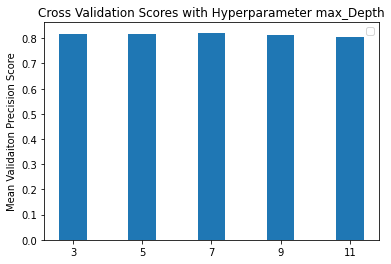

[1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1 0
 0 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0
 0 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 1
 1 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0
 1 0 1 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1
 1 0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 1 0 0 1 1 1 0 0
 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1
 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1
 0 1 1 0 1 0 1 0 1 0 0 0 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 0 1 1
 1 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1
 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1
 1 1 1 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1
 0 0 1 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1
 1 0 0 0 1 0 0 0 0 0 1 1 

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
import matplotlib.pyplot as plt

# Train decision tree classifiers
cv_Parameter = {'max_depth':[3, 5, 7, 9, 11],}

dt = DecisionTreeClassifier()
grid = GridSearchCV(dt,
                    cv_Parameter, 
                    cv=5,
                    scoring='accuracy')

grid_search = grid.fit(X_train, y_train)

# Plot errors
#plt.plot(cv_Parameter['max_depth'],grid_search.cv_results_['mean_test_score'])
plt.bar(cv_Parameter['max_depth'],grid_search.cv_results_['mean_test_score'])
plt.title('Cross Validation Scores with Hyperparameter max_Depth')
#plt.xlabel('max_Depth Values')
plt.xticks(cv_Parameter['max_depth'])#ADDED FOR BAR CHART
plt.ylabel('Mean Validaiton Precision Score')
plt.legend()
plt.show()

predictions = grid_search.predict(X_valid)
print(predictions)
print(X_valid)


# Report your accuracy
from sklearn.metrics import accuracy_score,precision_score # you can find your scoring metric in this library

testAccuracy = accuracy_score(y_valid,predictions)
testPrecision = precision_score(y_valid,predictions)

print("Testing Accuracy = %.5f%%" % (testAccuracy * 100))

In [ ]:
from xgboost import XGBRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from numpy import absolute
model = XGBRegressor()

# define model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)



scores = absolute(scores)
print('Mean MAE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Mean MAE: 0.278 (0.013)


In [ ]:
import xgboost
model = XGBRegressor()
model = XGBRegressor(n_estimators=1000, max_depth=7, eta=0.1, subsample=0.7, colsample_bytree=0.8)

# define model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)



scores = absolute(scores)
print('Mean MAE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Mean MAE: 0.274 (0.015)


In [ ]:
import xgboost as xgb

regressor=xgb.XGBRegressor(eval_metric='rmsle')

#=========================================================================
# exhaustively search for the optimal hyperparameters
#=========================================================================
from sklearn.model_selection import GridSearchCV
# set up our search grid
param_grid = {"max_depth":    [4, 5],
              "n_estimators": [500, 600, 700],
              "learning_rate": [0.01, 0.015]}

# try out every combination of the above values
search = GridSearchCV(regressor, param_grid, cv=5).fit(X_train, y_train)

print("The best hyperparameters are ",search.best_params_)

regressor=xgb.XGBRegressor(learning_rate = search.best_params_["learning_rate"],
                           n_estimators  = search.best_params_["n_estimators"],
                           max_depth     = search.best_params_["max_depth"],)

regressor.fit(X_train, y_train)

#=========================================================================
# To use early_stopping_rounds: 
# "Validation metric needs to improve at least once in every 
# early_stopping_rounds round(s) to continue training."
#=========================================================================
# first perform a test/train split 
#from sklearn.model_selection import train_test_split

#X_train,X_test,y_train,y_test = train_test_split(X_train,y_train, test_size = 0.2)
#regressor.fit(X_train, y_train, early_stopping_rounds=6, eval_set=[(X_test, y_test)], verbose=False)

#=========================================================================
# use the model to predict the prices for the test data
#=========================================================================
predictions = regressor.predict(X_valid)

/usr/local/lib/python3.8/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
60 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
60 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.8/dist-packages/xgboost/sklearn.py", line 391, in fit
    self._Booster = train(params, trainDmatrix,
  File "/usr/local/lib/python3.8/dist-packages/xgboost/training.py", line 212, in train
    return _train_internal(params, dtrain,
  File "/usr/local/lib/python3.8/dist-packages/xgboost

XGBoostError: ignored

In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_valid)

accuracy = accuracy_score(y_valid, y_pred)
print("ACCURACY: ",accuracy)

from sklearn.metrics import mean_squared_error
MSE = mean_squared_error(y_valid,y_pred)

print("MSE: ",MSE)

[18:54:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


ValueError: ignored

In [ ]:
import pandas  as pd
import numpy   as np




In [ ]:
from xgboost import XGBClassifier
political_model = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')

political_model.fit(X_train, y_train)

y_pred = political_model.predict(X_valid)

accuracy = accuracy_score(y_valid, y_pred)
print("ACCURACY: ",accuracy)

from sklearn.metrics import mean_squared_error
MSE = mean_squared_error(y_valid,y_pred)

print("MSE: ",MSE)

ACCURACY:  0.8316708229426434
MSE:  0.16832917705735662


In [ ]:
from sklearn.model_selection import cross_validate
def cross_validation(model, _X, _y, _cv=5):
      '''Function to perform 5 Folds Cross-Validation
       Parameters
       ----------
      model: Python Class, default=None
              This is the machine learning algorithm to be used for training.
      _X: array
           This is the matrix of features.
      _y: array
           This is the target variable.
      _cv: int, default=5
          Determines the number of folds for cross-validation.
       Returns
       -------
       The function returns a dictionary containing the metrics 'accuracy', 'precision',
       'recall', 'f1' for both training set and validation set.
      '''
     # _scoring = ['accuracy', 'precision', 'recall', 'f1']
      _scoring = ['precision', 'recall', 'f1']
      results = cross_validate(estimator=model,
                               X=_X,
                               y=_y,
                               cv=_cv,
                               scoring=_scoring,
                               return_train_score=True)
      
      return {#"Training Accuracy scores": results['train_accuracy'],
              #"Mean Training Accuracy": results['train_accuracy'].mean()*100,
              "Training Precision scores": results['train_precision'],
              "Mean Training Precision": results['train_precision'].mean(),
              "Training Recall scores": results['train_recall'],
              "Mean Training Recall": results['train_recall'].mean(),
              "Training F1 scores": results['train_f1'],
              "Mean Training F1 Score": results['train_f1'].mean(),
              #"Validation Accuracy scores": results['test_accuracy'],
              #"Mean Validation Accuracy": results['test_accuracy'].mean()*100,
              "Validation Precision scores": results['test_precision'],
              "Mean Validation Precision": results['test_precision'].mean(),
              "Validation Recall scores": results['test_recall'],
              "Mean Validation Recall": results['test_recall'].mean(),
              "Validation F1 scores": results['test_f1'],
              "Mean Validation F1 Score": results['test_f1'].mean()
              }

In [ ]:
def plot_result(x_label, y_label, plot_title, train_data, val_data):
        '''Function to plot a grouped bar chart showing the training and validation
          results of the ML model in each fold after applying K-fold cross-validation.
         Parameters
         ----------
         x_label: str, 
            Name of the algorithm used for training e.g 'Decision Tree'
          
         y_label: str, 
            Name of metric being visualized e.g 'Accuracy'
         plot_title: str, 
            This is the title of the plot e.g 'Accuracy Plot'
         
         train_result: list, array
            This is the list containing either training precision, accuracy, or f1 score.
        
         val_result: list, array
            This is the list containing either validation precision, accuracy, or f1 score.
         Returns
         -------
         The function returns a Grouped Barchart showing the training and validation result
         in each fold.
        '''
        
        # Set size of plot
        plt.figure(figsize=(12,6))
        labels = ["1st Fold", "2nd Fold", "3rd Fold", "4th Fold", "5th Fold"]
        X_axis = np.arange(len(labels))
        ax = plt.gca()
        plt.ylim(0.40000, 1)
        plt.bar(X_axis-0.2, train_data, 0.4, color='blue', label='Training')
        plt.bar(X_axis+0.2, val_data, 0.4, color='red', label='Validation')
        plt.title(plot_title, fontsize=30)
        plt.xticks(X_axis, labels)
        plt.xlabel(x_label, fontsize=14)
        plt.ylabel(y_label, fontsize=14)
        plt.legend()
        plt.grid(True)
        plt.show()

In [ ]:
political_model = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')
model_result = cross_validation(political_model, X_train, y_train, 5)
print(model_result)

{'Training Precision scores': array([0.8044895 , 0.79354839, 0.79855072, 0.80100937, 0.80854197]), 'Mean Training Precision': 0.8012279916667749, 'Training Recall scores': array([0.87549251, 0.87234043, 0.86771654, 0.87480315, 0.86456693]), 'Mean Training Recall': 0.8709839106991059, 'Training F1 scores': array([0.83849057, 0.83108108, 0.83169811, 0.83628152, 0.83561644]), 'Mean Training F1 Score': 0.8346335438388769, 'Validation Precision scores': array([0.76923077, 0.79261364, 0.78857143, 0.78323699, 0.79881657]), 'Mean Validation Precision': 0.7864938792865649, 'Validation Recall scores': array([0.8490566 , 0.87735849, 0.87066246, 0.85488959, 0.85173502]), 'Mean Validation Recall': 0.8607404321171359, 'Validation F1 scores': array([0.80717489, 0.83283582, 0.82758621, 0.81749623, 0.82442748]), 'Mean Validation F1 Score': 0.8219041251722834}


In [ ]:
from sklearn.ensemble import AdaBoostClassifier

abc = AdaBoostClassifier(n_estimators=50,
                         learning_rate=1)
# Train Adaboost Classifer
model = abc.fit(X_train, y_train)

#Predict the response for test dataset
y_pred = model.predict(X_valid)


print("Accuracy:",accuracy_score(y_valid, y_pred))

Accuracy: 0.8129675810473815


In [ ]:
from sklearn.ensemble import AdaBoostClassifier

# Import Support Vector Classifier
from sklearn.svm import SVC
#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics
svc=SVC(probability=True, kernel='linear')

# Create adaboost classifer object
abc =AdaBoostClassifier(n_estimators=50, base_estimator=svc,learning_rate=1)

# Train Adaboost Classifer
model = abc.fit(X_train, y_train)

#Predict the response for test dataset
y_pred = model.predict(X_valid)


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_valid, y_pred))

In [ ]:
from keras.models import Sequential
from keras.layers import Dense

model = Sequential([
    Dense(32, activation='relu', input_shape=(7,)),
    Dense(32, activation='relu'),
    Dense(1, activation='sigmoid'),
])

model.compile(optimizer='Adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

hist = model.fit(X_train, y_train,
          batch_size=32, epochs=100,
          validation_data=(X_valid, y_valid))

model.evaluate(X_valid, y_valid)[1]

Epoch 1/100
101/101 [==============================] - 1s 4ms/step - loss: 0.6862 - accuracy: 0.6311 - val_loss: 0.8157 - val_accuracy: 0.6845
Epoch 2/100
101/101 [==============================] - 0s 2ms/step - loss: 0.6474 - accuracy: 0.7188 - val_loss: 0.6024 - val_accuracy: 0.7469
Epoch 3/100
101/101 [==============================] - 0s 3ms/step - loss: 0.6834 - accuracy: 0.7356 - val_loss: 0.5574 - val_accuracy: 0.7431
Epoch 4/100
101/101 [==============================] - 0s 2ms/step - loss: 0.6793 - accuracy: 0.7428 - val_loss: 0.6047 - val_accuracy: 0.7431
Epoch 5/100
101/101 [==============================] - 0s 2ms/step - loss: 0.6610 - accuracy: 0.7363 - val_loss: 0.5504 - val_accuracy: 0.7344
Epoch 6/100
101/101 [==============================] - 0s 3ms/step - loss: 0.5846 - accuracy: 0.7444 - val_loss: 0.9290 - val_accuracy: 0.7406
Epoch 7/100
101/101 [==============================] - 0s 2ms/step - loss: 0.5890 - accuracy: 0.7366 - val_loss: 0.8997 - val_accuracy: 0.7282

0.8167082071304321

In [ ]:
# RANDOM FOREST CLASSIFIER
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error

n_estimators = [20,50,80,100] # number of trees in the random forest
max_features = ['auto', 'sqrt'] # number of features in consideration at every split
max_depth = [int(x) for x in np.linspace(10, 120, num = 12)] # maximum number of levels allowed in each decision tree
min_samples_split = [2, 6, 8, 10] # minimum sample number to split a node
min_samples_leaf = [1, 3, 4] # minimum sample number that can be stored in a leaf node
bootstrap = [True, False] # method used to sample data points

randomGrid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

randomForestModel = RandomForestClassifier()
#cv : In this we have to pass a interger value, as it signifies the number of splits that is needed for cross validation. By default is set as five.
#n_iter : This signifies the number of parameter settings that are sampled. By default it is set as 10.
#n_jobs : This signifies the number of jobs to be run in parallel, -1 signifies to use all processor.
randomForestRandomness = RandomizedSearchCV(estimator = randomForestModel,
                                            param_distributions = randomGrid,
                                            cv = 5, 
                                            n_iter = 10,
                                            n_jobs = -1,
                                            verbose=2, 
                                            random_state=35, 
                                            )
randomForestRandomness.fit(X_train, y_train)
randomForestPolitical = RandomForestClassifier(max_depth=20, min_samples_leaf=6, min_samples_split=10, n_estimators=100)
randomForestPolitical.fit(X_train, y_train)
predictionsPolitical_RF = randomForestPolitical.predict(X_valid)
print("MSE: ", mean_squared_error(y_valid, predictionsPolitical_RF))
print("Accuracy Score:",accuracy_score(y_valid, predictionsPolitical_RF))
print("Confusion Matrix: \n",confusion_matrix(y_valid, predictionsPolitical_RF))


Fitting 5 folds for each of 10 candidates, totalling 50 fits
MSE:  0.16957605985037408
Accuracy Score: 0.830423940149626
Confusion Matrix: 
 [[309  77]
 [ 59 357]]


In [ ]:
from sklearn.linear_model import LogisticRegression

dtc_bot = LogisticRegression(max_iter=1000)
dtc_bot.fit(X_train, y_train)

preds = dtc_bot.predict(X_valid)
print(preds)
# evaluate on validation set
acc_score = accuracy_score(y_valid, preds)
confusion = confusion_matrix(y_valid, preds)
mse = mean_squared_error(y_valid, preds)

print("MSE:", mse, "\n",
      "Accuracy Score:", acc_score, "\n",
      "Confusion Matrix:", "\n", confusion)

MSE: 0.22942643391521197 
 Accuracy Score: 0.770573566084788 
 Confusion Matrix: 
 [[329  57]
 [127 289]]


In [ ]:
import xgboost as xgb

regressorPolitical=xgb.XGBRegressor(eval_metric='rmsle')

#=========================================================================
# exhaustively search for the optimal hyperparameters
#=========================================================================
#from sklearn.model_selection import GridSearchCV
'''set up our search grid
param_grid = {"max_depth":    [4, 5],
              "n_estimators": [500, 600, 700],
              "learning_rate": [0.01, 0.015]}

# try out every combination of the above values
search = GridSearchCV(regressor, param_grid, cv=5).fit(X_train, y_train)

print("The best hyperparameters are ",search.best_params_)
'''
regressorPolitical=xgb.XGBRegressor(learning_rate = 0.015,
                           n_estimators  = 700,
                           max_depth     = 6)

regressorPolitical.fit(X_train, y_train)

#=========================================================================
# To use early_stopping_rounds: 
# "Validation metric needs to improve at least once in every 
# early_stopping_rounds round(s) to continue training."
#=========================================================================
# first perform a test/train split 
#from sklearn.model_selection import train_test_split

#X_train,X_test,y_train,y_test = train_test_split(X_train,y_train, test_size = 0.2)
#regressor.fit(X_train, y_train, early_stopping_rounds=6, eval_set=[(X_test, y_test)], verbose=False)

#=========================================================================
# use the model to predict the prices for the test data
#=========================================================================
predictions = regressorPolitical.predict(X_valid)

for i in range(0,len(predictions)):
  if (predictions[i] > 1):
    predictions[i] = 1
  elif (predictions[i] < 0):
    predictions[i] = 0
# evaluate on validation set
print(predictions)

mse = mean_squared_error(y_valid, predictions)

print("MSE:", mse, "\n")


[18:49:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[6.19572341e-01 1.12800688e-01 8.03246081e-01 1.56410396e-01
 1.52981192e-01 9.53166902e-01 1.12800688e-01 1.81574523e-01
 3.42713177e-01 6.51394367e-01 3.27544719e-01 3.23072731e-01
 1.23030543e-02 1.00493729e-02 3.31634760e-01 1.00000000e+00
 9.30346131e-01 8.83709311e-01 9.57336962e-01 6.68254197e-01
 1.81574523e-01 9.66337800e-01 8.67455602e-02 1.56410396e-01
 9.52910364e-01 7.58110702e-01 9.61822748e-01 3.23072731e-01
 9.01512504e-01 1.23030543e-02 4.89662588e-02 8.58873427e-01
 8.18060398e-01 9.28881109e-01 9.71646905e-01 7.65494347e-01
 1.06556296e-01 5.39806902e-01 9.13492799e-01 9.20419335e-01
 3.49500477e-02 1.23030543e-02 7.46742070e-01 1.93034142e-01
 6.82683885e-01 1.64591074e-02 2.76159823e-01 8.01593661e-01
 8.92331362e-01 0.00000000e+00 2.07547963e-01 7.73862481e-01
 9.01559293e-01 6.46854103e-01 8.64045978e-01 9.33498383e-01
 8.41164231e-01 4.5

## 2.2. Bot Detection

### 2.2.1. Merge dfBotAll data with labels

In [ ]:
dfBotAll.user_screen_name = dfBotAll.user_screen_name.str.lower()

In [ ]:
dfBotAll_train = dfBotAll.merge(trainingUserDf,
                               left_on='user_screen_name',
                               right_on='screen_name')

dfBotAll_train

,user_id,user_name,user_screen_name,user_location,user_description,user_followers_count,user_friends_count,description_len,followers_to_all_ratio,retweet_total_ratio,num_median_favorites,num_of_tweets,screen_name,isBot
0,1512081815292432394,sezgin,sezgin953116371,,,46,430,0,0.096639,0.050251,0.0,199.0,sezgin953116371,No
1,1425452291428077571,Adem Koç,gogoadem61,,,14,171,0,0.075676,0.761062,0.0,113.0,gogoadem61,No
2,328164303,Necmettin Balıkçı,dewil511,,,21,49,0,0.300000,0.010101,0.0,198.0,dewil511,Yes
3,1343666971368431622,Night Bird⁷🦉,midnight__bird,,"La vie est un sommeil, l’amour en est le rêve...",422,260,48,0.618768,0.085000,1.0,200.0,midnight__bird,No
4,1240932880488038400,Samed Pınarcı,samedpinarci,,Orman Mühendisi - Orman İşletme Şefi - Orman G...,133,202,60,0.397015,0.780000,0.0,200.0,samedpinarci,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,1286770207134973954,Hamide Arabacı,anka6054,,,151,61,0,0.712264,0.000000,1.0,200.0,anka6054,No
2996,1598032338323214338,atamabekleyenbahceci,atamabekleyenzz,,,173,367,0,0.320370,0.580000,0.0,200.0,atamabekleyenzz,No
2997,760235343966863360,Emrah İNCİ,memrahinci,Istanbul - Bayburt,Researcher | Middle East | Political Science |...,5863,5905,71,0.498215,0.040000,36.0,200.0,memrahinci,No
2998,1553973684100124672,Murat Kkk,muratkkk18,,Normal sıradan bir insanım,1,10,26,0.090909,0.769231,0.0,13.0,muratkkk18,No


In [ ]:
trainingUserDf.isBot.value_counts()

No     2424
Yes     576
Name: isBot, dtype: int64

### 2.2.2. Separate X and y values
We use only 4 features here to create a baseline model. However, it is not enough to get good results.

In [ ]:
X = dfBotAll_train[['description_len', 'followers_to_all_ratio', 'retweet_total_ratio', 'num_median_favorites','user_friends_count','num_of_tweets','user_followers_count']]
y = dfBotAll_train.isBot.apply(lambda x: 1 if x=='Yes' else 0)

In [ ]:
oversample = SMOTE()
X, y = oversample.fit_resample(X, y)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.20, random_state=42)

### 2.2.4. Train the model

In [ ]:
from xgboost import XGBClassifier
model = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')

model.fit(X_train, y_train)

y_pred = model.predict(X_valid)

accuracy = accuracy_score(y_valid, y_pred)
print("ACCURACY: ",accuracy)

from sklearn.metrics import mean_squared_error
MSE = mean_squared_error(y_valid,y_pred)

print("MSE: ",MSE)

ACCURACY:  0.8
MSE:  0.2


In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error

n_estimators = [5,20,50,100] # number of trees in the random forest
max_features = ['auto', 'sqrt'] # number of features in consideration at every split
max_depth = [int(x) for x in np.linspace(10, 120, num = 12)] # maximum number of levels allowed in each decision tree
min_samples_split = [2, 6, 10] # minimum sample number to split a node
min_samples_leaf = [1, 3, 4] # minimum sample number that can be stored in a leaf node
bootstrap = [True, False] # method used to sample data points

param_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

rfbot = RandomForestClassifier()

rf_random = RandomizedSearchCV(
    estimator = rfbot,
    param_distributions = param_grid,
    n_iter = 10, 
    cv = 5, 
    verbose=2, 
    random_state=35, 
    n_jobs = -1)

rf_random.fit(X_train, y_train)

print ('best_params: ', rf_random.best_params_)
print('best_estimator: ',rf_random.best_estimator_)

rand_forest_bot = RandomForestClassifier(max_depth=60, max_features='sqrt', min_samples_leaf=4, min_samples_split=10)

rand_forest_bot.fit(X_train, y_train)

preds = rand_forest_bot.predict(X_valid)

print("MSE: ", mean_squared_error(y_valid, preds))
print("Accuracy Score:",accuracy_score(y_valid, preds))
print("Confusion Matrix: \n",confusion_matrix(y_valid, preds))


Fitting 5 folds for each of 10 candidates, totalling 50 fits
best_params:  {'n_estimators': 100, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 'auto', 'max_depth': 120, 'bootstrap': False}
best_estimator:  RandomForestClassifier(bootstrap=False, max_depth=120, min_samples_leaf=3,
                       min_samples_split=6)
MSE:  0.18041237113402062
Accuracy Score: 0.8195876288659794
Confusion Matrix: 
 [[383 119]
 [ 56 412]]


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error

# create an instance
dtc_bot = DecisionTreeClassifier()

# fit your model
dtc_bot.fit(X_train, y_train)

# make predictions
preds = dtc_bot.predict(X_valid)

# evaluate on validation set
acc_score = accuracy_score(y_valid, preds)
confusion = confusion_matrix(y_valid, preds)

print("MSE:", mse, "\n",
      "Accuracy Score:", acc_score, "\n",
      "Confusion Matrix:", "\n", confusion)

MSE: 0.13245485480651908 
 Accuracy Score: 0.7466666666666667 
 Confusion Matrix: 
 [[406  87]
 [ 65  42]]


In [ ]:
import xgboost as xgb

regressorBot=xgb.XGBRegressor(eval_metric='rmsle')

#=========================================================================
# exhaustively search for the optimal hyperparameters
#=========================================================================
#from sklearn.model_selection import GridSearchCV
'''set up our search grid
param_grid = {"max_depth":    [4, 5],
              "n_estimators": [500, 600, 700],
              "learning_rate": [0.01, 0.015]}

# try out every combination of the above values
search = GridSearchCV(regressor, param_grid, cv=5).fit(X_train, y_train)

print("The best hyperparameters are ",search.best_params_)
'''
regressorBot=xgb.XGBRegressor(learning_rate = 0.015,
                           n_estimators  = 700,
                           max_depth     = 6)

regressorBot.fit(X_train, y_train)

#=========================================================================
# To use early_stopping_rounds: 
# "Validation metric needs to improve at least once in every 
# early_stopping_rounds round(s) to continue training."
#=========================================================================
# first perform a test/train split 
#from sklearn.model_selection import train_test_split

#X_train,X_test,y_train,y_test = train_test_split(X_train,y_train, test_size = 0.2)
#regressor.fit(X_train, y_train, early_stopping_rounds=6, eval_set=[(X_test, y_test)], verbose=False)

#=========================================================================
# use the model to predict the prices for the test data
#=========================================================================
predictions_bot = regressorBot.predict(X_valid)
for i in range(0,len(predictions_bot)):
  if (predictions_bot[i] > 1):
    predictions_bot[i] = 1
  elif (predictions_bot[i] < 0):
    predictions_bot[i] = 0
print(predictions_bot)

#print(predictions)
# evaluate on validation set

mse = mean_squared_error(y_valid, predictions_bot)

print("MSE:", mse, "\n")

[18:44:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[8.18570971e-01 0.00000000e+00 2.88179576e-01 1.00000000e+00
 5.82629144e-02 4.78255659e-01 1.41540587e-01 7.70602703e-01
 1.00000000e+00 7.33450413e-01 9.45420027e-01 1.18705809e-01
 1.53952271e-01 1.81769133e-01 9.32854295e-01 7.44680166e-01
 0.00000000e+00 8.28802288e-02 3.41270626e-01 8.67123723e-01
 7.87969470e-01 3.54937553e-01 6.30804896e-02 5.21561027e-01
 8.36482882e-01 2.45534033e-01 7.48391151e-01 3.57902586e-01
 5.68392634e-01 8.25436473e-01 7.51594841e-01 0.00000000e+00
 9.15361881e-01 8.24506700e-01 9.75185454e-01 8.62003446e-01
 8.77117693e-01 0.00000000e+00 4.72478569e-02 6.20894730e-01
 4.17613328e-01 5.65619469e-01 7.97424793e-01 1.36920482e-01
 5.70273340e-01 9.75142479e-01 3.76377225e-01 8.84599805e-01
 7.32041836e-01 1.25335842e-01 7.66793072e-01 3.98714840e-02
 2.62969434e-02 5.43595254e-02 2.80455828e-01 3.83318961e-01
 7.73199439e-01 5.3

# 3. MAKE PREDICTIONS

Here, you will make predictions with the models that you have trained above.

## 3.1. Predictions for Tweets (Political or Not)

In [ ]:
# read the evaluation file as follows
evaluationTweetDf = pd.read_csv('{}evaluation-round{}-tweet.csv'.format(DATA_PATH,ROUND), dtype={0: str}, header=None, names=['tweet_id'])
evaluationTweetDf = evaluationTweetDf.dropna()


# merge it with the political dataframe so that you can use the make predictions based on the variables
dfPolitical_test = dfPolitical.merge(evaluationTweetDf)
# define X as we did above in section (2.x.2. Separate X and y values)
X = dfPolitical_test[['num_political_entities','num_hashtags','num_mentions', "wordScore", "hashtagScore", "mentionScore"]]
print(X)
# make predictions based on these variables
predictions_political = regressorPolitical.predict(X)
for i in range(0,len(predictions_political)):
  if (predictions_political[i] > 1):
    predictions_political[i] = 1
  elif (predictions_political[i] < 0):
    predictions_political[i] = 0

      num_political_entities  num_hashtags  num_mentions  wordScore  \
0                          5             0             1   0.148701   
1                          2             0             3   0.000000   
2                          8             0             1   0.000000   
3                          4             0             1   1.100000   
4                         22             1             2   1.890260   
...                      ...           ...           ...        ...   
4995                      10             0             2   0.592857   
4996                      16             1             2   0.547403   
4997                       4             0             1   0.000000   
4998                       0             0             1   0.000000   
4999                      17             1             2   1.828571   

      hashtagScore  mentionScore  
0         0.000000      0.000000  
1         0.000000      0.000000  
2         0.000000      0.000000  
3      

### This part is important! We expect you to return your predictions in the following format:

In [ ]:
modelPredTweet = dict([(x,float(y)) for x,y in zip([*dfPolitical_test.tweet_id], predictions_political)])
modelPredTweet

{'1434787703783051264': 0.6448348760604858,
 '1367571642604544000': 0.05823850631713867,
 '1589993032975544320': 0.35674333572387695,
 '1565312596135354373': 0.9240993857383728,
 '1579558096833511424': 0.15293949842453003,
 '1439547067337256967': 0.04896625876426697,
 '1559963768372740098': 0.2761598229408264,
 '1562853131251118081': 0.021611332893371582,
 '1586021183958704128': 0.792083740234375,
 '1585766233491886081': 0.7647159099578857,
 '1427746815420604417': 0.11280068755149841,
 '1352635736537882629': 0.09561052918434143,
 '1415032260571680768': 0.04896625876426697,
 '1548636597628899328': 0.9299492835998535,
 '1564926450096013313': 0.4393010437488556,
 '1585634359612420101': 0.8561795949935913,
 '1597138789108895744': 0.4309249222278595,
 '1391681495622995971': 0.047155946493148804,
 '1389951943343316995': 0.04896625876426697,
 '1452348722810138646': 0.5957195162773132,
 '1595829502021623812': 0.8767911195755005,
 '1413108476348354562': 0.09561052918434143,
 '157940839889413734

## 3.2. Predictions for Users (Bot or Not)

In [ ]:
evaluationUserDf = pd.read_csv(DATA_PATH+'evaluation-round2-user.csv', dtype={0: str}, header=None, names=['user_screen_name'])
evaluationUserDf = evaluationUserDf.dropna()

# merge it with the political dataframe so that you can use the make predictions based on the variables
dfBot_test = dfBotAll.merge(evaluationUserDf)

# define X as we did above in section (2.x.2. Separate X and y values)
X = dfBot_test[['description_len', 'followers_to_all_ratio', 'retweet_total_ratio', 'num_median_favorites','user_friends_count','num_of_tweets','user_followers_count']]


# make predictions based on these variables
predictions_bot = regressorBot.predict(X)
for i in range(0,len(predictions_bot)):
  if (predictions_bot[i] > 1):
    predictions_bot[i] = 1
  elif (predictions_bot[i] < 0):
    predictions_bot[i] = 0

In [ ]:
modelPredUser = dict([(x,float(y)) for x,y in zip([*dfBot_test.user_screen_name], predictions_bot)])
modelPredUser

{'nedenburdaysam': 0.0,
 'biologselim': 0.8491819500923157,
 'bilgin21604923': 0.45452991127967834,
 'denizlihabercom': 0.0389268696308136,
 'burakerbaychp': 0.042654186487197876,
 'mustafaarst': 0.0,
 'mvnez': 0.21279498934745789,
 'farukhalit2': 0.1742965281009674,
 'harlunoshi': 0.08325859904289246,
 'tamerduran_1': 0.35695478320121765,
 'donkisotumsu': 0.1885625720024109,
 'enveraysevera': 0.10413813591003418,
 'gendenmukatol': 0.1342235505580902,
 '1905anason': 0.7628443837165833,
 'dasiskein': 0.2883923649787903,
 'ercan_bas29': 0.20150136947631836,
 'mett_1907': 0.11193916201591492,
 'haberinyokcokk': 0.08848750591278076,
 'han34nesli': 0.009723782539367676,
 'mehmetaltay64': 0.16439786553382874,
 'nurtencam2': 0.8532915115356445,
 'berkeduranovic': 0.45085158944129944,
 'cagdasadim': 0.19610419869422913,
 'yorumsuzadam87': 0.7599599361419678,
 'twitsildiren': 0.3258739709854126,
 'nurdiyoloji': 0.03851443529129028,
 'merabalare': 0.0,
 'sevdaac72373936': 0.6896028518676758,
 'c

# PREPARE SUBMISSION

You will need to submit exact same file produced by using the following code. Any deviation from the desired format willbe marked as 0.

In [ ]:
# Explain your approach

data_explanations = '''
After creating dataframes, we applied various methods to the rows of dataframes in order to extract additional features from data.
We get the table dataframe by seperating input values into X from output value y.
For isPolitic Prediction;
X = ['num_political_entities','total_interactions','num_hashtags','num_mentions', 'wordScore', 'hashtagScore', 'mentionScore','num_retweets']
y = [isPolitic]

For isBot Prediction;
X = ['description_len', 'followers_to_all_ratio', 'retweet_total_ratio', 'num_median_favorites','user_friends_count','num_of_tweets','user_followers_count']
y = [isBot]

'''


feature_explanations = '''
wordScore: it is the normalized score of the words based on n-grams of the political words
hashtagScore: it is normalized score based on n-grams of the hashtags in hashtags of political tweets.
mentionScore: it is normalized score based on n-grams of the mentions in mentiones of political tweets.
num_political_entities: number of words, which are prepared by both hand and data, assoicated with politics.
num_retweets: the number of retweets.
isVerified: it shows whether an account is verified or not.
user_followers_count: it shows the number of followers count of an account.
user_friends_count: it shows the number of friends count of an account.

'''

model_explanations = '''
What did you try and used for modeling
We have tried different models including the following,
Decision trees
Random forest with grid search
K Nearest Neigbours
AdaBoost
Adaboost with Support Vector Machines
XgBoost
and we have decided to the use XgBoost with regression
'''

additional_explanations = '''
Any other tricks that you tried for the project
'''


In [ ]:
predictions = {
    'round': ROUND,
    'student_id': STUDENT_ID,
    'user_predictions': modelPredUser,
    'tweet_predictions': modelPredTweet,
    'explanations': {
        'data': data_explanations,
        'feature': feature_explanations,
        'model': model_explanations,
        'other': additional_explanations,
    }
}


with open('predictions-{}_round{}.json'.format(STUDENT_ID, ROUND), 'w') as fl:
    fl.write(json.dumps(predictions, indent=4))

In [ ]:
# Test your submission file

submission = json.load(open('predictions-{}_round{}.json'.format(STUDENT_ID, ROUND), 'r'))
submission

{'round': 3,
 'student_id': '28198',
 'user_predictions': {'nedenburdaysam': 0.0,
  'biologselim': 0.8491819500923157,
  'bilgin21604923': 0.45452991127967834,
  'denizlihabercom': 0.0389268696308136,
  'burakerbaychp': 0.042654186487197876,
  'mustafaarst': 0.0,
  'mvnez': 0.21279498934745789,
  'farukhalit2': 0.1742965281009674,
  'harlunoshi': 0.08325859904289246,
  'tamerduran_1': 0.35695478320121765,
  'donkisotumsu': 0.1885625720024109,
  'enveraysevera': 0.10413813591003418,
  'gendenmukatol': 0.1342235505580902,
  '1905anason': 0.7628443837165833,
  'dasiskein': 0.2883923649787903,
  'ercan_bas29': 0.20150136947631836,
  'mett_1907': 0.11193916201591492,
  'haberinyokcokk': 0.08848750591278076,
  'han34nesli': 0.009723782539367676,
  'mehmetaltay64': 0.16439786553382874,
  'nurtencam2': 0.8532915115356445,
  'berkeduranovic': 0.45085158944129944,
  'cagdasadim': 0.19610419869422913,
  'yorumsuzadam87': 0.7599599361419678,
  'twitsildiren': 0.3258739709854126,
  'nurdiyoloji': 0